
# Introduction to Computer Vision

Summer Semester 2022, 31.05.2022, Otto von Guericke University Magdeburg.

In this exercise, we will again work with the [car racing](https://gym.openai.com/envs/CarRacing-v0/) environment from [Gym](http://gym.openai.com). Our goal is to apply different computer vision approaches to the simulator.

In this exercise, the goal is to generate a mosaic/panorama from multiple images. Therefore, you should generate three consecutive frames with the car racing environment. The mosaic/panorma should then be generated from the extracted consecutive frames. 

*Important*: You need to install [Gym](http://gym.openai.com) in your system. The installation can be done with pip or by installing from the sources. More information at [https://gym.openai.com/docs/#installation](https://gym.openai.com/docs/#installation).

The solutions for the assignment may be a Python Notebook or .py files. The visual results can be integrated into the notebook or a PDF document.

## 1. Image Extraction 

In this step, you should use the car racing environment to extract three consecutive frames from the car drving on the track. The frames should be saved as image files. Note that the bar at the bottom of the image should be removed. 

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cv2

Track generation: 1149..1440 -> 291-tiles track


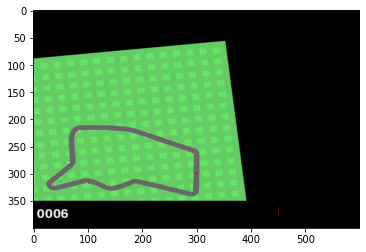


action ['+0.00', '+0.00', '+0.00']
step 0 total_reward +6.80


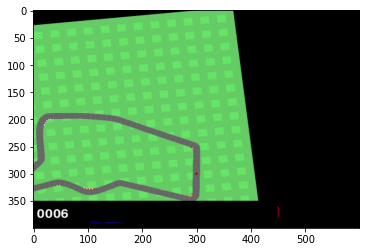

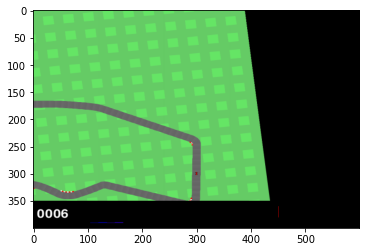

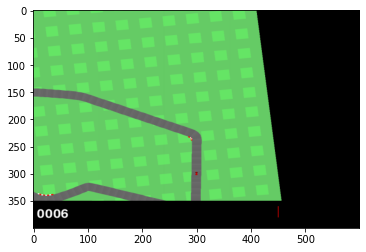

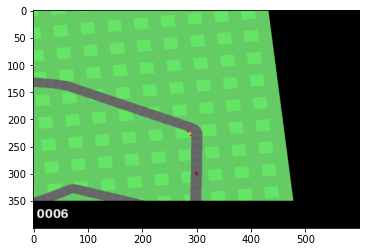

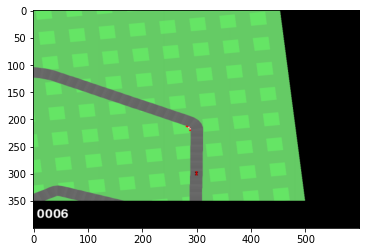

...

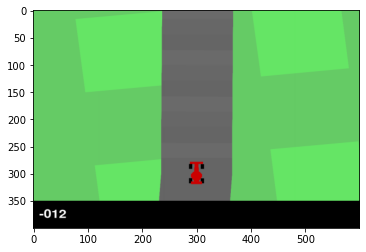

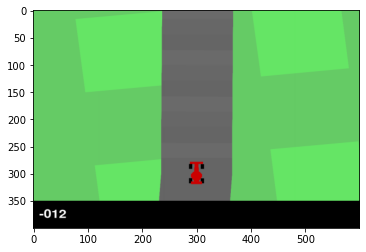

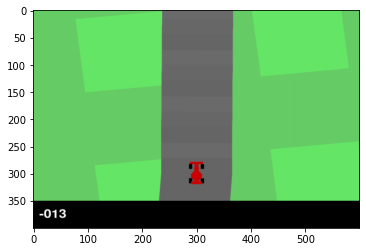

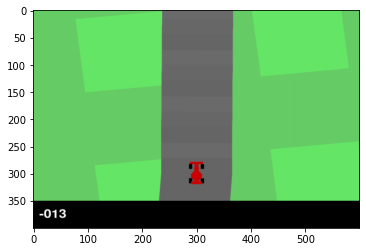

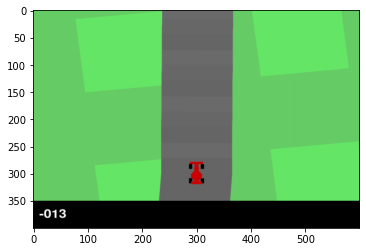


action ['+0.00', '+0.00', '+0.00']
step 200 total_reward -13.20


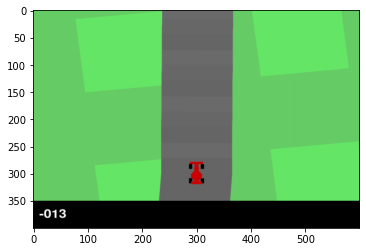

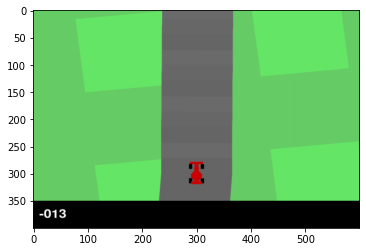

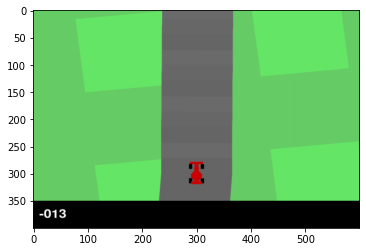

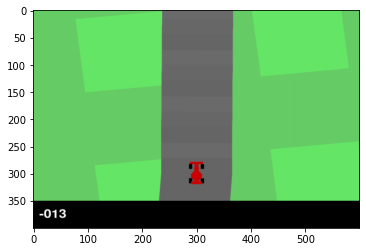

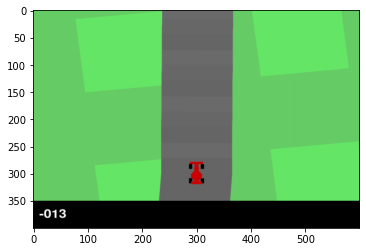

...

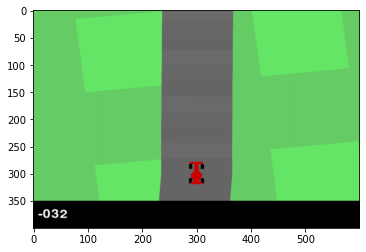

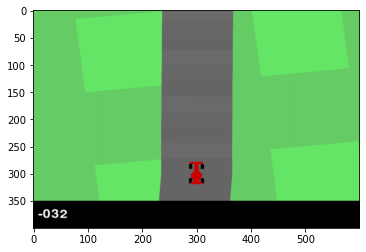

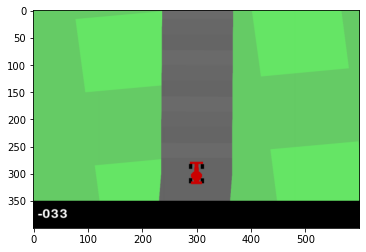

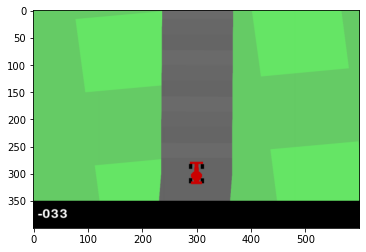

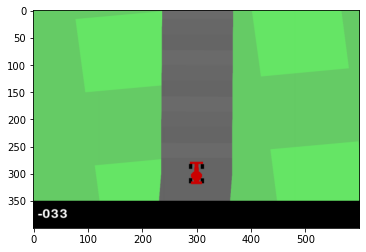


action ['+0.00', '+0.00', '+0.00']
step 400 total_reward -33.20


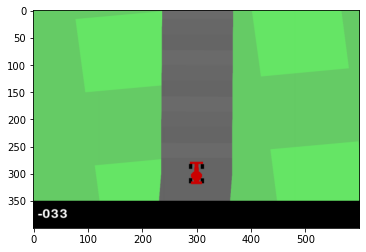

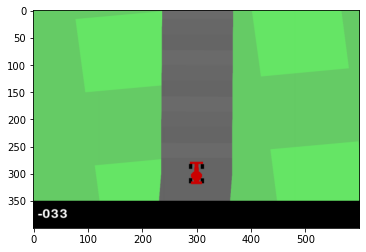

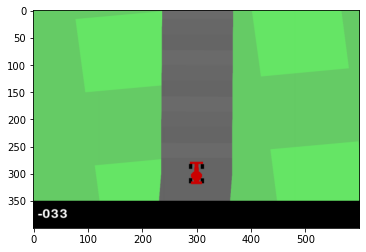

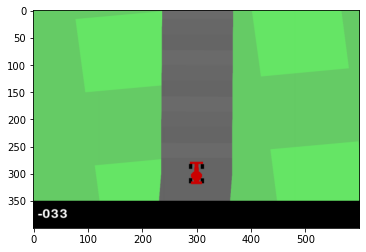

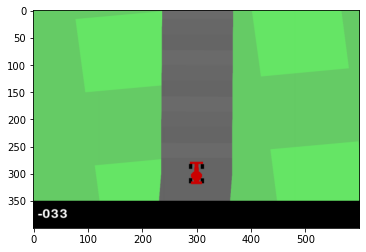

...

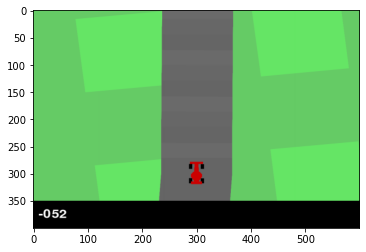

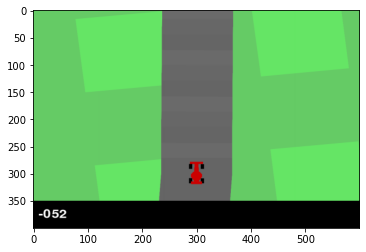

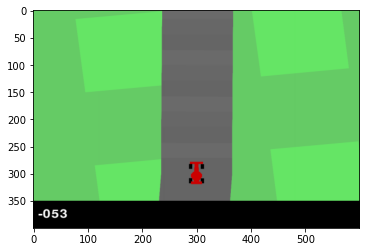

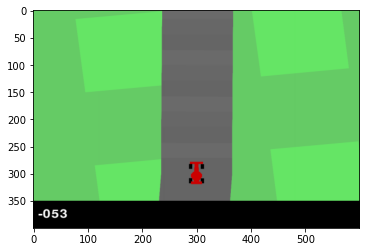

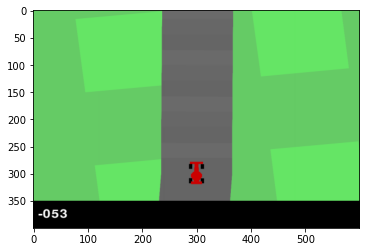


action ['+0.00', '+0.00', '+0.00']
step 600 total_reward -53.20


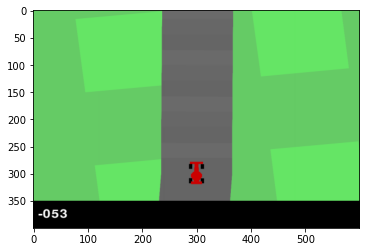

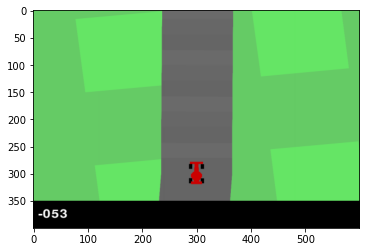

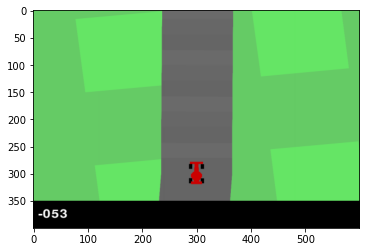

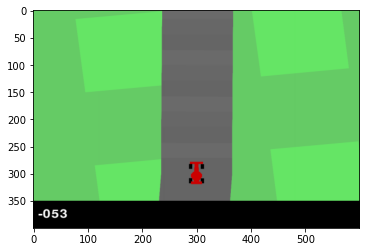

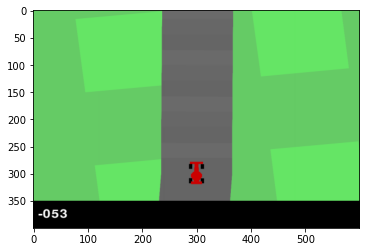

...

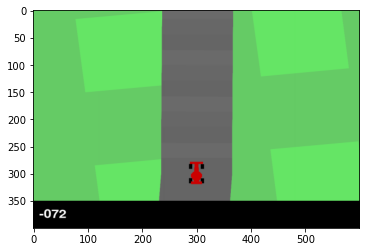

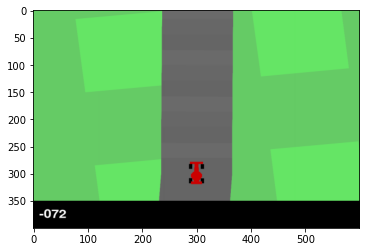

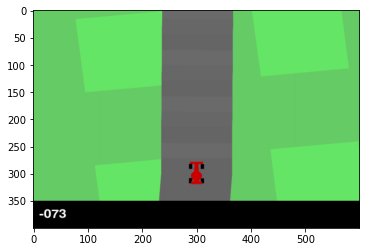

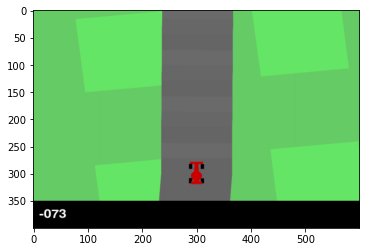

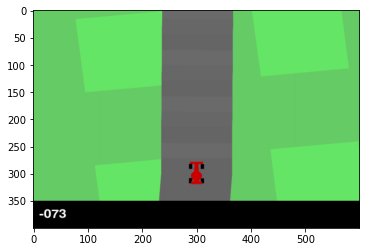


action ['+0.00', '+0.00', '+0.00']
step 800 total_reward -73.20


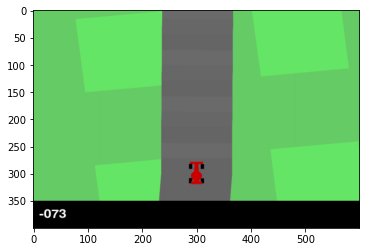

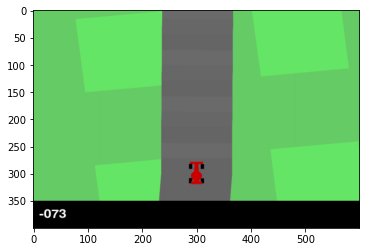

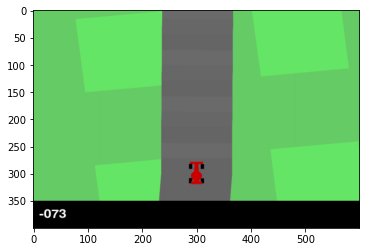

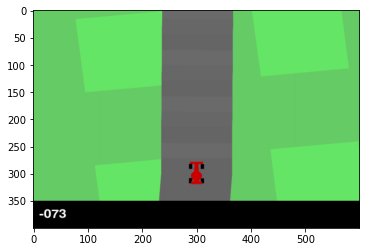

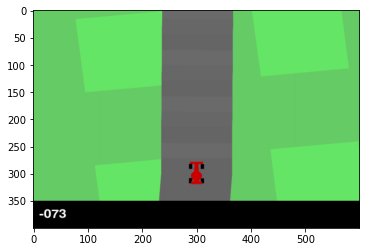

...

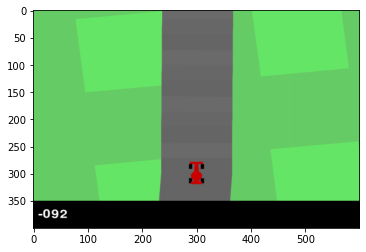

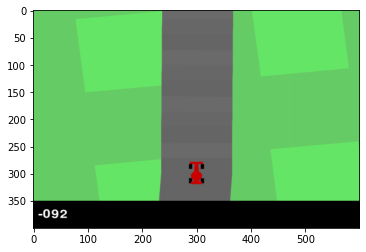

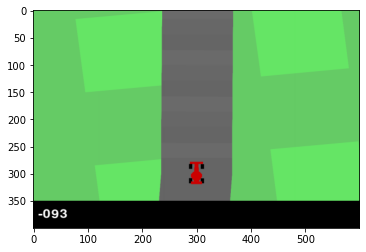

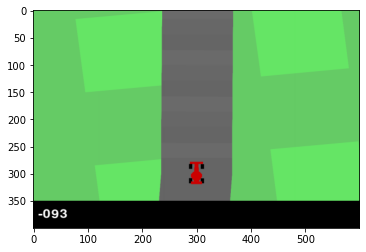

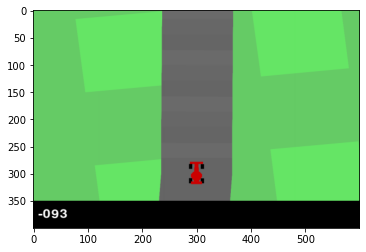


action ['+0.00', '+0.00', '+0.00']
step 1000 total_reward -93.20


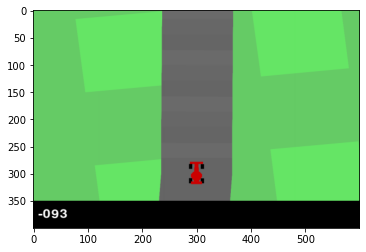

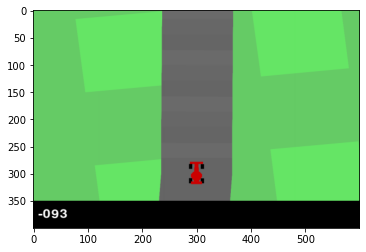

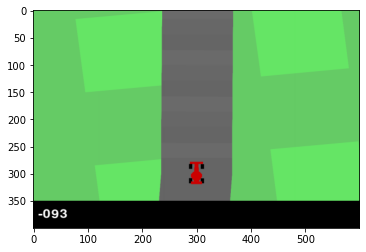

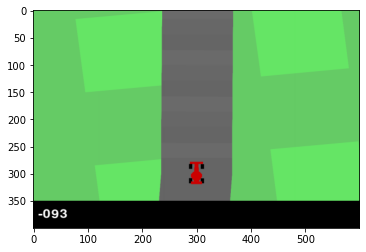

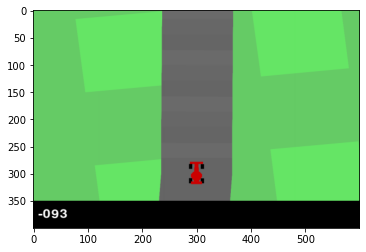

...

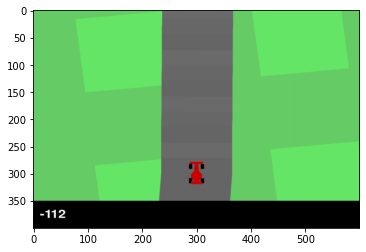

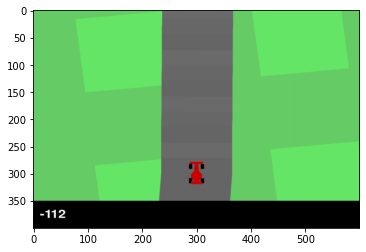

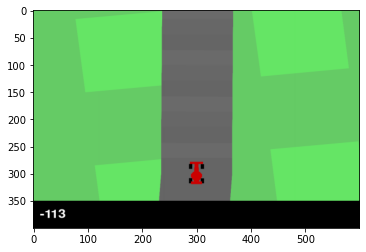

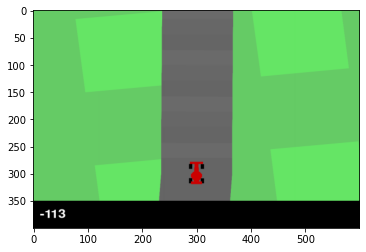

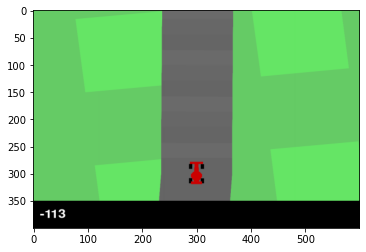


action ['+0.00', '+0.00', '+0.00']
step 1200 total_reward -113.20


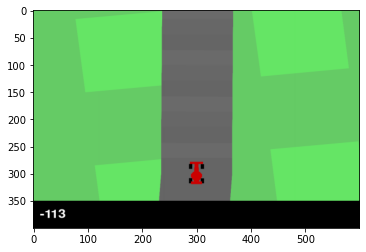

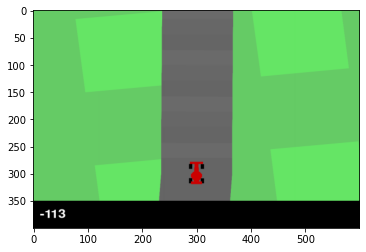

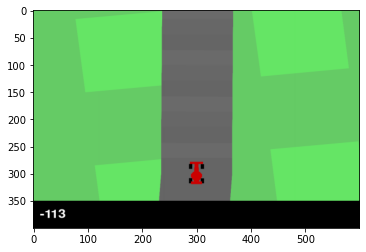

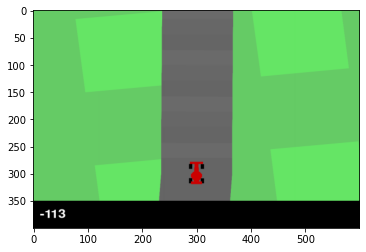

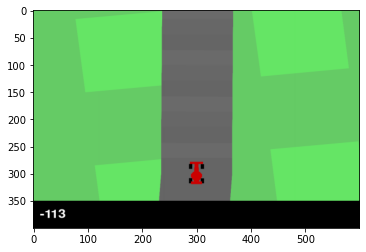

...

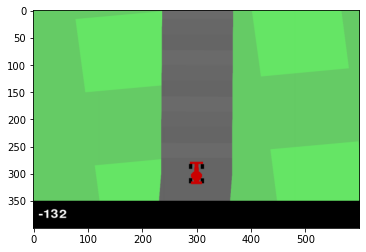

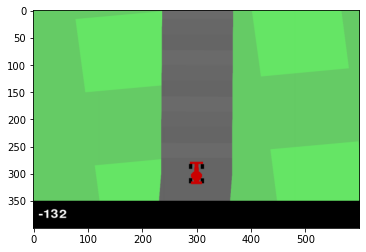

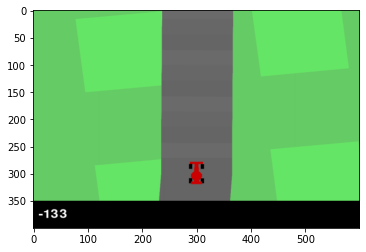

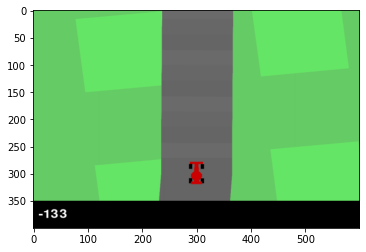

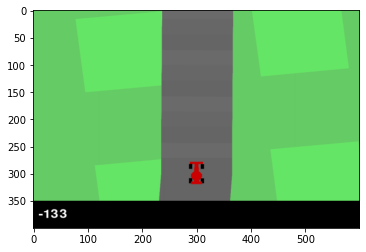


action ['+0.00', '+0.00', '+0.00']
step 1400 total_reward -133.20


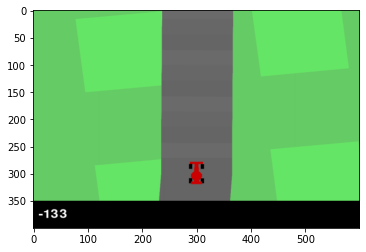

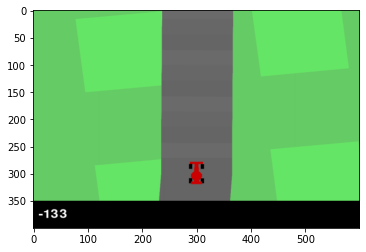

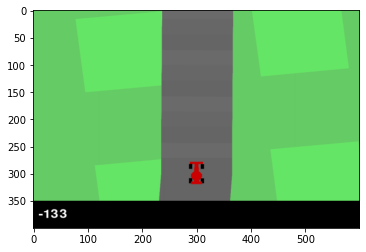

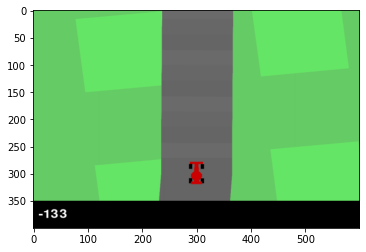

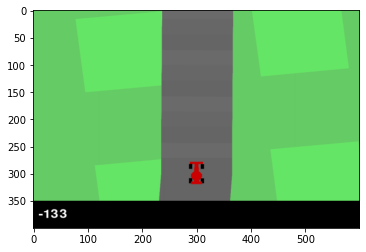

...

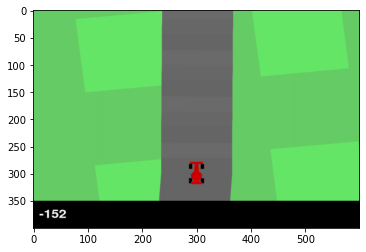

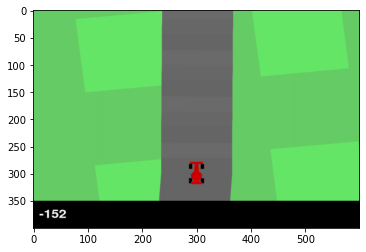

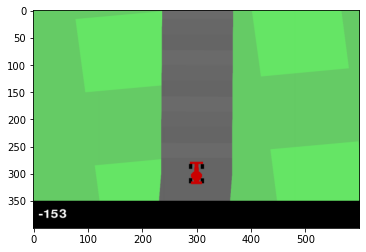

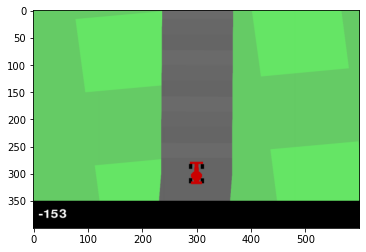

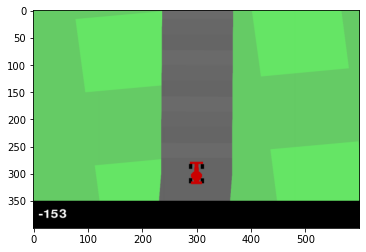


action ['+0.00', '+0.00', '+0.00']
step 1600 total_reward -153.20


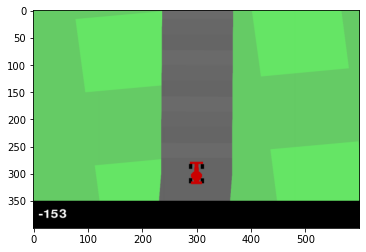

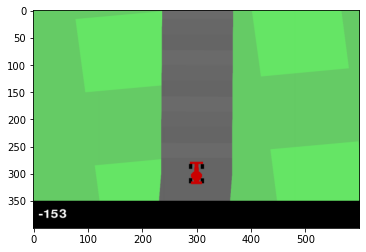

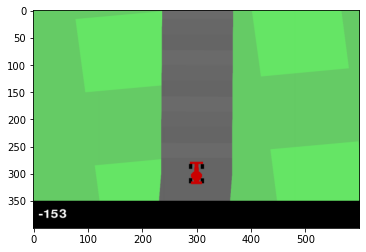

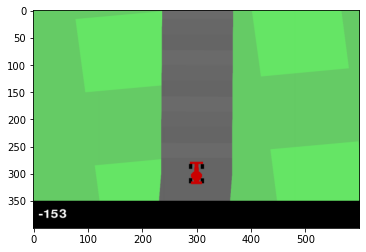

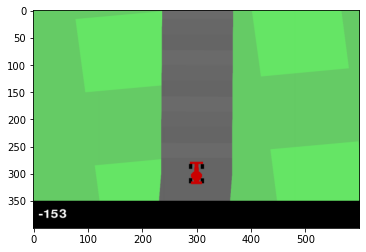

...

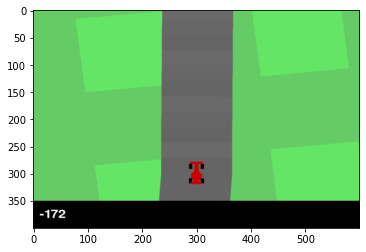

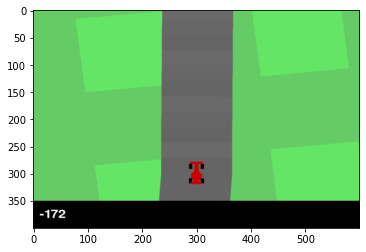

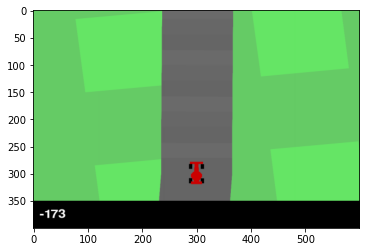

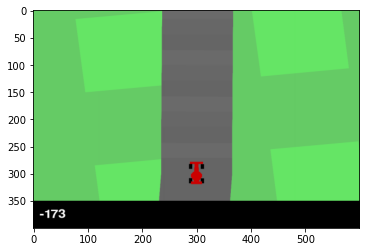

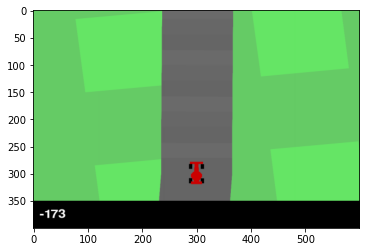


action ['+0.00', '+0.00', '+0.00']
step 1800 total_reward -173.20


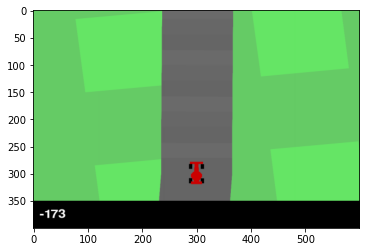

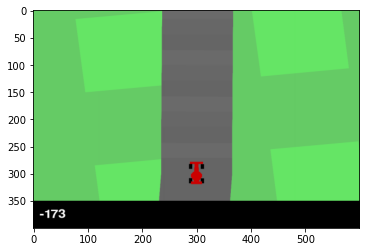

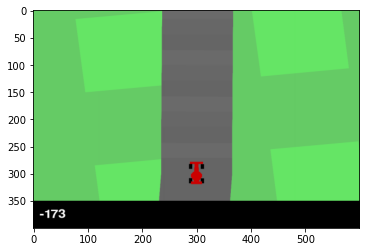

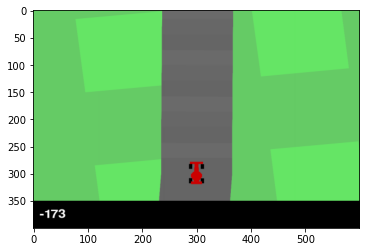

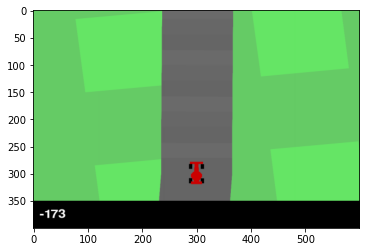

...

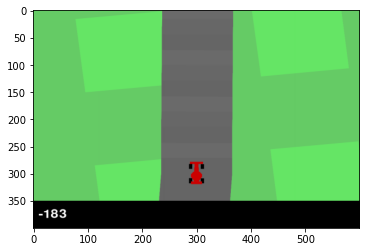

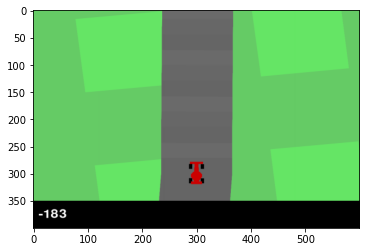

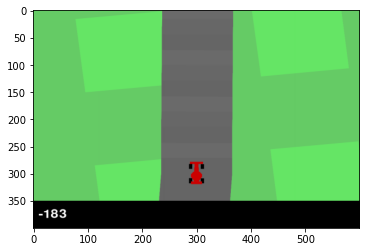

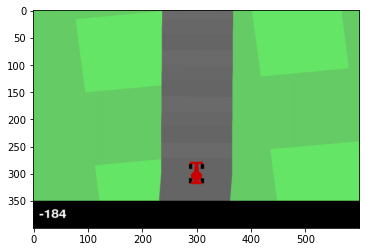

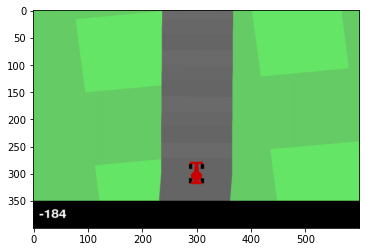

In [ ]:
__credits__ = ["Andrea PIERRÉ"]

import math
import sys
from typing import Optional

import Box2D
import numpy as np
from Box2D.b2 import contactListener, fixtureDef, polygonShape

import gym
from gym import spaces
from gym.envs.box2d.car_dynamics import Car
from gym.utils import EzPickle, seeding

STATE_W = 96  # less than Atari 160x192
STATE_H = 96
VIDEO_W = 600
VIDEO_H = 400
WINDOW_W = 1000
WINDOW_H = 800

SCALE = 6.0  # Track scale
TRACK_RAD = 900 / SCALE  # Track is heavily morphed circle with this radius
PLAYFIELD = 2000 / SCALE  # Game over boundary
FPS = 50  # Frames per second
ZOOM = 2.7  # Camera zoom
ZOOM_FOLLOW = True  # Set to False for fixed view (don't use zoom)


TRACK_DETAIL_STEP = 21 / SCALE
TRACK_TURN_RATE = 0.31
TRACK_WIDTH = 40 / SCALE
BORDER = 8 / SCALE
BORDER_MIN_COUNT = 4

ROAD_COLOR = [0.4, 0.4, 0.4]


class FrictionDetector(contactListener):
    def __init__(self, env, lap_complete_percent):
        contactListener.__init__(self)
        self.env = env
        self.lap_complete_percent = lap_complete_percent

    def BeginContact(self, contact):
        self._contact(contact, True)

    def EndContact(self, contact):
        self._contact(contact, False)

    def _contact(self, contact, begin):
        tile = None
        obj = None
        u1 = contact.fixtureA.body.userData
        u2 = contact.fixtureB.body.userData
        if u1 and "road_friction" in u1.__dict__:
            tile = u1
            obj = u2
        if u2 and "road_friction" in u2.__dict__:
            tile = u2
            obj = u1
        if not tile:
            return

        tile.color[0] = ROAD_COLOR[0]
        tile.color[1] = ROAD_COLOR[1]
        tile.color[2] = ROAD_COLOR[2]
        if not obj or "tiles" not in obj.__dict__:
            return
        if begin:
            obj.tiles.add(tile)
            if not tile.road_visited:
                tile.road_visited = True
                self.env.reward += 1000.0 / len(self.env.track)
                self.env.tile_visited_count += 1

                # Lap is considered completed if enough % of the track was covered
                if (
                    tile.idx == 0
                    and self.env.tile_visited_count / len(self.env.track)
                    > self.lap_complete_percent
                ):
                    self.env_new_lap = True
        else:
            obj.tiles.remove(tile)


class CarRacing(gym.Env, EzPickle):
    """
    ### Description
    The easiest continuous control task to learn from pixels - a top-down
    racing environment. Discrete control is reasonable in this environment as
    well; on/off discretization is fine.
    The game is solved when the agent consistently gets 900+ points.
    The generated track is random every episode.
    Some indicators are shown at the bottom of the window along with the
    state RGB buffer. From left to right: true speed, four ABS sensors,
    steering wheel position, and gyroscope.
    To play yourself (it's rather fast for humans), type:
    ```
    python gym/envs/box2d/car_racing.py
    ```
    Remember: it's a powerful rear-wheel drive car - don't press the accelerator
    and turn at the same time.
    ### Action Space
    There are 3 actions: steering (-1 is full left, +1 is full right), gas,
    and breaking.
    ### Observation Space
    State consists of 96x96 pixels.
    ### Rewards
    The reward is -0.1 every frame and +1000/N for every track tile visited,
    where N is the total number of tiles visited in the track. For example,
    if you have finished in 732 frames, your reward is
    1000 - 0.1*732 = 926.8 points.
    ### Starting State
    The car starts at rest in the center of the road.
    ### Episode Termination
    The episode finishes when all of the tiles are visited. The car can also go
    outside of the playfield - that is, far off the track, in which case it will
    receive -100 reward and die.
    ### Arguments
    There are no arguments supported in constructing the environment.
    ### Version History
    - v0: Current version
    ### References
    - Chris Campbell (2014), http://www.iforce2d.net/b2dtut/top-down-car.
    ### Credits
    Created by Oleg Klimov
    """

    metadata = {
        "render_modes": ["human", "rgb_array", "state_pixels"],
        "render_fps": FPS,
    }

    def __init__(self, verbose=1, lap_complete_percent=0.95):
        EzPickle.__init__(self)
        self.contactListener_keepref = FrictionDetector(self, lap_complete_percent)
        self.world = Box2D.b2World((0, 0), contactListener=self.contactListener_keepref)
        self.screen = None
        self.clock = None
        self.isopen = True
        self.invisible_state_window = None
        self.invisible_video_window = None
        self.road = None
        self.car = None
        self.reward = 0.0
        self.prev_reward = 0.0
        self.verbose = verbose
        self.new_lap = False
        self.fd_tile = fixtureDef(
            shape=polygonShape(vertices=[(0, 0), (1, 0), (1, -1), (0, -1)])
        )

        # This will throw a warning in tests/envs/test_envs in utils/env_checker.py as the space is not symmetric
        #   or normalised however this is not possible here so ignore
        self.action_space = spaces.Box(
            np.array([-1, 0, 0]).astype(np.float32),
            np.array([+1, +1, +1]).astype(np.float32),
        )  # steer, gas, brake

        self.observation_space = spaces.Box(
            low=0, high=255, shape=(STATE_H, STATE_W, 3), dtype=np.uint8
        )

    def _destroy(self):
        if not self.road:
            return
        for t in self.road:
            self.world.DestroyBody(t)
        self.road = []
        self.car.destroy()

    def _create_track(self):
        CHECKPOINTS = 12

        # Create checkpoints
        checkpoints = []
        for c in range(CHECKPOINTS):
            noise = self.np_random.uniform(0, 2 * math.pi * 1 / CHECKPOINTS)
            alpha = 2 * math.pi * c / CHECKPOINTS + noise
            rad = self.np_random.uniform(TRACK_RAD / 3, TRACK_RAD)

            if c == 0:
                alpha = 0
                rad = 1.5 * TRACK_RAD
            if c == CHECKPOINTS - 1:
                alpha = 2 * math.pi * c / CHECKPOINTS
                self.start_alpha = 2 * math.pi * (-0.5) / CHECKPOINTS
                rad = 1.5 * TRACK_RAD

            checkpoints.append((alpha, rad * math.cos(alpha), rad * math.sin(alpha)))
        self.road = []

        # Go from one checkpoint to another to create track
        x, y, beta = 1.5 * TRACK_RAD, 0, 0
        dest_i = 0
        laps = 0
        track = []
        no_freeze = 2500
        visited_other_side = False
        while True:
            alpha = math.atan2(y, x)
            if visited_other_side and alpha > 0:
                laps += 1
                visited_other_side = False
            if alpha < 0:
                visited_other_side = True
                alpha += 2 * math.pi

            while True:  # Find destination from checkpoints
                failed = True

                while True:
                    dest_alpha, dest_x, dest_y = checkpoints[dest_i % len(checkpoints)]
                    if alpha <= dest_alpha:
                        failed = False
                        break
                    dest_i += 1
                    if dest_i % len(checkpoints) == 0:
                        break

                if not failed:
                    break

                alpha -= 2 * math.pi
                continue

            r1x = math.cos(beta)
            r1y = math.sin(beta)
            p1x = -r1y
            p1y = r1x
            dest_dx = dest_x - x  # vector towards destination
            dest_dy = dest_y - y
            # destination vector projected on rad:
            proj = r1x * dest_dx + r1y * dest_dy
            while beta - alpha > 1.5 * math.pi:
                beta -= 2 * math.pi
            while beta - alpha < -1.5 * math.pi:
                beta += 2 * math.pi
            prev_beta = beta
            proj *= SCALE
            if proj > 0.3:
                beta -= min(TRACK_TURN_RATE, abs(0.001 * proj))
            if proj < -0.3:
                beta += min(TRACK_TURN_RATE, abs(0.001 * proj))
            x += p1x * TRACK_DETAIL_STEP
            y += p1y * TRACK_DETAIL_STEP
            track.append((alpha, prev_beta * 0.5 + beta * 0.5, x, y))
            if laps > 4:
                break
            no_freeze -= 1
            if no_freeze == 0:
                break

        # Find closed loop range i1..i2, first loop should be ignored, second is OK
        i1, i2 = -1, -1
        i = len(track)
        while True:
            i -= 1
            if i == 0:
                return False  # Failed
            pass_through_start = (
                track[i][0] > self.start_alpha and track[i - 1][0] <= self.start_alpha
            )
            if pass_through_start and i2 == -1:
                i2 = i
            elif pass_through_start and i1 == -1:
                i1 = i
                break
        if self.verbose == 1:
            print("Track generation: %i..%i -> %i-tiles track" % (i1, i2, i2 - i1))
        assert i1 != -1
        assert i2 != -1

        track = track[i1 : i2 - 1]

        first_beta = track[0][1]
        first_perp_x = math.cos(first_beta)
        first_perp_y = math.sin(first_beta)
        # Length of perpendicular jump to put together head and tail
        well_glued_together = np.sqrt(
            np.square(first_perp_x * (track[0][2] - track[-1][2]))
            + np.square(first_perp_y * (track[0][3] - track[-1][3]))
        )
        if well_glued_together > TRACK_DETAIL_STEP:
            return False

        # Red-white border on hard turns
        border = [False] * len(track)
        for i in range(len(track)):
            good = True
            oneside = 0
            for neg in range(BORDER_MIN_COUNT):
                beta1 = track[i - neg - 0][1]
                beta2 = track[i - neg - 1][1]
                good &= abs(beta1 - beta2) > TRACK_TURN_RATE * 0.2
                oneside += np.sign(beta1 - beta2)
            good &= abs(oneside) == BORDER_MIN_COUNT
            border[i] = good
        for i in range(len(track)):
            for neg in range(BORDER_MIN_COUNT):
                border[i - neg] |= border[i]

        # Create tiles
        for i in range(len(track)):
            alpha1, beta1, x1, y1 = track[i]
            alpha2, beta2, x2, y2 = track[i - 1]
            road1_l = (
                x1 - TRACK_WIDTH * math.cos(beta1),
                y1 - TRACK_WIDTH * math.sin(beta1),
            )
            road1_r = (
                x1 + TRACK_WIDTH * math.cos(beta1),
                y1 + TRACK_WIDTH * math.sin(beta1),
            )
            road2_l = (
                x2 - TRACK_WIDTH * math.cos(beta2),
                y2 - TRACK_WIDTH * math.sin(beta2),
            )
            road2_r = (
                x2 + TRACK_WIDTH * math.cos(beta2),
                y2 + TRACK_WIDTH * math.sin(beta2),
            )
            vertices = [road1_l, road1_r, road2_r, road2_l]
            self.fd_tile.shape.vertices = vertices
            t = self.world.CreateStaticBody(fixtures=self.fd_tile)
            t.userData = t
            c = 0.01 * (i % 3)
            t.color = [ROAD_COLOR[0] + c, ROAD_COLOR[1] + c, ROAD_COLOR[2] + c]
            t.road_visited = False
            t.road_friction = 1.0
            t.idx = i
            t.fixtures[0].sensor = True
            self.road_poly.append(([road1_l, road1_r, road2_r, road2_l], t.color))
            self.road.append(t)
            if border[i]:
                side = np.sign(beta2 - beta1)
                b1_l = (
                    x1 + side * TRACK_WIDTH * math.cos(beta1),
                    y1 + side * TRACK_WIDTH * math.sin(beta1),
                )
                b1_r = (
                    x1 + side * (TRACK_WIDTH + BORDER) * math.cos(beta1),
                    y1 + side * (TRACK_WIDTH + BORDER) * math.sin(beta1),
                )
                b2_l = (
                    x2 + side * TRACK_WIDTH * math.cos(beta2),
                    y2 + side * TRACK_WIDTH * math.sin(beta2),
                )
                b2_r = (
                    x2 + side * (TRACK_WIDTH + BORDER) * math.cos(beta2),
                    y2 + side * (TRACK_WIDTH + BORDER) * math.sin(beta2),
                )
                self.road_poly.append(
                    ([b1_l, b1_r, b2_r, b2_l], (1, 1, 1) if i % 2 == 0 else (1, 0, 0))
                )
        self.track = track
        return True

    def reset(
        self,
        *,
        seed: Optional[int] = None,
        return_info: bool = False,
        options: Optional[dict] = None,
    ):
        super().reset(seed=seed)
        self._destroy()
        self.reward = 0.0
        self.prev_reward = 0.0
        self.tile_visited_count = 0
        self.t = 0.0
        self.new_lap = False
        self.road_poly = []

        while True:
            success = self._create_track()
            if success:
                break
            if self.verbose == 1:
                print(
                    "retry to generate track (normal if there are not many"
                    "instances of this message)"
                )
        self.car = Car(self.world, *self.track[0][1:4])

        if not return_info:
            return self.step(None)[0]
        else:
            return self.step(None)[0], {}

    def step(self, action):
        if action is not None:
            self.car.steer(-action[0])
            self.car.gas(action[1])
            self.car.brake(action[2])

        self.car.step(1.0 / FPS)
        self.world.Step(1.0 / FPS, 6 * 30, 2 * 30)
        self.t += 1.0 / FPS

        self.state = self.render("state_pixels")

        step_reward = 0
        done = False
        if action is not None:  # First step without action, called from reset()
            self.reward -= 0.1
            # We actually don't want to count fuel spent, we want car to be faster.
            # self.reward -=  10 * self.car.fuel_spent / ENGINE_POWER
            self.car.fuel_spent = 0.0
            step_reward = self.reward - self.prev_reward
            self.prev_reward = self.reward
            if self.tile_visited_count == len(self.track) or self.new_lap:
                done = True
            x, y = self.car.hull.position
            if abs(x) > PLAYFIELD or abs(y) > PLAYFIELD:
                done = True
                step_reward = -100

        return self.state, step_reward, done, {}

    def render(self, mode="human"):
        import pygame

        pygame.font.init()

        assert mode in ["human", "state_pixels", "rgb_array"]
        if self.screen is None and mode == "human":
            pygame.init()
            pygame.display.init()
            self.screen = pygame.display.set_mode((WINDOW_W, WINDOW_H))
        if self.clock is None:
            self.clock = pygame.time.Clock()

        if "t" not in self.__dict__:
            return  # reset() not called yet

        self.surf = pygame.Surface((WINDOW_W, WINDOW_H))

        # computing transformations
        angle = -self.car.hull.angle
        # Animating first second zoom.
        zoom = 0.1 * SCALE * max(1 - self.t, 0) + ZOOM * SCALE * min(self.t, 1)
        scroll_x = -(self.car.hull.position[0] + PLAYFIELD) * zoom
        scroll_y = -(self.car.hull.position[1] + PLAYFIELD) * zoom
        trans = pygame.math.Vector2((scroll_x, scroll_y)).rotate_rad(angle)
        trans = (WINDOW_W / 2 + trans[0], WINDOW_H / 4 + trans[1])

        self.render_road(zoom, trans, angle)
        self.car.draw(self.surf, zoom, trans, angle, mode != "state_pixels")

        self.surf = pygame.transform.flip(self.surf, False, True)

        # showing stats
        self.render_indicators(WINDOW_W, WINDOW_H)

        font = pygame.font.Font(pygame.font.get_default_font(), 42)
        text = font.render("%04i" % self.reward, True, (255, 255, 255), (0, 0, 0))
        text_rect = text.get_rect()
        text_rect.center = (60, WINDOW_H - WINDOW_H * 2.5 / 40.0)
        self.surf.blit(text, text_rect)

        if mode == "human":
            pygame.event.pump()
            self.clock.tick(self.metadata["render_fps"])
            self.screen.fill(0)
            self.screen.blit(self.surf, (0, 0))
            pygame.display.flip()

        if mode == "rgb_array":
            return self._create_image_array(self.surf, (VIDEO_W, VIDEO_H))
        elif mode == "state_pixels":
            return self._create_image_array(self.surf, (STATE_W, STATE_H))
        else:
            return self.isopen

    def render_road(self, zoom, translation, angle):
        bounds = PLAYFIELD
        field = [
            (2 * bounds, 2 * bounds),
            (2 * bounds, 0),
            (0, 0),
            (0, 2 * bounds),
        ]
        trans_field = []
        self.draw_colored_polygon(
            self.surf, field, (102, 204, 102), zoom, translation, angle
        )

        k = bounds / (20.0)
        grass = []
        for x in range(0, 40, 2):
            for y in range(0, 40, 2):
                grass.append(
                    [
                        (k * x + k, k * y + 0),
                        (k * x + 0, k * y + 0),
                        (k * x + 0, k * y + k),
                        (k * x + k, k * y + k),
                    ]
                )
        for poly in grass:
            self.draw_colored_polygon(
                self.surf, poly, (102, 230, 102), zoom, translation, angle
            )

        for poly, color in self.road_poly:
            # converting to pixel coordinates
            poly = [(p[0] + PLAYFIELD, p[1] + PLAYFIELD) for p in poly]
            color = [int(c * 255) for c in color]
            self.draw_colored_polygon(self.surf, poly, color, zoom, translation, angle)

    def render_indicators(self, W, H):
        import pygame

        s = W / 40.0
        h = H / 40.0
        color = (0, 0, 0)
        polygon = [(W, H), (W, H - 5 * h), (0, H - 5 * h), (0, H)]
        pygame.draw.polygon(self.surf, color=color, points=polygon)

        def vertical_ind(place, val):
            return [
                (place * s, H - (h + h * val)),
                ((place + 1) * s, H - (h + h * val)),
                ((place + 1) * s, H - h),
                ((place + 0) * s, H - h),
            ]

        def horiz_ind(place, val):
            return [
                ((place + 0) * s, H - 4 * h),
                ((place + val) * s, H - 4 * h),
                ((place + val) * s, H - 2 * h),
                ((place + 0) * s, H - 2 * h),
            ]

        true_speed = np.sqrt(
            np.square(self.car.hull.linearVelocity[0])
            + np.square(self.car.hull.linearVelocity[1])
        )

        # simple wrapper to render if the indicator value is above a threshold
        def render_if_min(value, points, color):
            if abs(value) > 1e-4:
                pygame.draw.polygon(self.surf, points=points, color=color)

        render_if_min(true_speed, vertical_ind(5, 0.02 * true_speed), (255, 255, 255))
        # ABS sensors
        render_if_min(
            self.car.wheels[0].omega,
            vertical_ind(7, 0.01 * self.car.wheels[0].omega),
            (0, 0, 255),
        )
        render_if_min(
            self.car.wheels[1].omega,
            vertical_ind(8, 0.01 * self.car.wheels[1].omega),
            (0, 0, 255),
        )
        render_if_min(
            self.car.wheels[2].omega,
            vertical_ind(9, 0.01 * self.car.wheels[2].omega),
            (51, 0, 255),
        )
        render_if_min(
            self.car.wheels[3].omega,
            vertical_ind(10, 0.01 * self.car.wheels[3].omega),
            (51, 0, 255),
        )

        render_if_min(
            self.car.wheels[0].joint.angle,
            horiz_ind(20, -10.0 * self.car.wheels[0].joint.angle),
            (0, 255, 0),
        )
        render_if_min(
            self.car.hull.angularVelocity,
            horiz_ind(30, -0.8 * self.car.hull.angularVelocity),
            (255, 0, 0),
        )

    def draw_colored_polygon(self, surface, poly, color, zoom, translation, angle):
        import pygame
        from pygame import gfxdraw

        poly = [pygame.math.Vector2(c).rotate_rad(angle) for c in poly]
        poly = [
            (c[0] * zoom + translation[0], c[1] * zoom + translation[1]) for c in poly
        ]
        gfxdraw.aapolygon(self.surf, poly, color)
        gfxdraw.filled_polygon(self.surf, poly, color)

    def _create_image_array(self, screen, size):
        import pygame

        scaled_screen = pygame.transform.smoothscale(screen, size)
        return np.transpose(
            np.array(pygame.surfarray.pixels3d(scaled_screen)), axes=(1, 0, 2)
        )

    def close(self):
        if self.screen is not None:
            import pygame

            pygame.display.quit()
            self.isopen = False
            pygame.quit()


if __name__ == "__main__":
    a = np.array([0.0, 0.0, 0.0])
    import pygame

    def register_input():
        for event in pygame.event.get():
            if event.type == pygame.KEYDOWN:
                if event.key == pygame.K_LEFT:
                    a[0] = -1.0
                if event.key == pygame.K_RIGHT:
                    a[0] = +1.0
                if event.key == pygame.K_UP:
                    a[1] = +1.0
                if event.key == pygame.K_DOWN:
                    a[2] = +0.8  # set 1.0 for wheels to block to zero rotation
                if event.key == pygame.K_RETURN:
                    global restart
                    restart = True

            if event.type == pygame.KEYUP:
                if event.key == pygame.K_LEFT:
                    a[0] = 0
                if event.key == pygame.K_RIGHT:
                    a[0] = 0
                if event.key == pygame.K_UP:
                    a[1] = 0
                if event.key == pygame.K_DOWN:
                    a[2] = 0

    env = CarRacing()
    env.render()
    
    isopen = True
    while isopen:
        env.reset()
        total_reward = 0.0
        steps = 0
        restart = False
        while True:
            register_input()
            s, r, done, info = env.step(a)
            total_reward += r
            img = env.render(mode = 'rgb_array')
            plt.imshow(img)
            plt.savefig('img_tbused.png')
            plt.show()
            if steps % 200 == 0 or done:
                print("\naction " + str([f"{x:+0.2f}" for x in a]))
                print(f"step {steps} total_reward {total_reward:+0.2f}")
            steps += 1
            isopen = env.render()
            if done or restart or isopen == False:
                break
    env.close()

## 2. SIFT Features 

SIFT stands for Scale Invariant Feature Transform and is used for feature dection in computer vision. The algorithm extracts local features that are rotation and scale invariant. These features are also referred to as `keypoints`. In this task, SIFT should be implemented and applied to the single images. Then, the feature correspondence between all image pairs should be established. 

Example: [https://www.analyticsvidhya.com/blog/2019/10/detailed-guide-powerful-sift-technique-image-matching-python/](https://www.analyticsvidhya.com/blog/2019/10/detailed-guide-powerful-sift-technique-image-matching-python/)

In [ ]:
#reading images
img1 = cv2.imread('G:\\OVGU Study\\Sem2\\Introduction to Computer Vision\\Assignments\\assign1\\image.png')
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.imread('G:\\OVGU Study\\Sem2\\Introduction to Computer Vision\\Assignments\\assign1\\image_test.png')

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#keypoints
sift = cv2.SIFT_create()
keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
img_1 = cv2.drawKeypoints(gray1,keypoints_1,img1)
plt.imshow(img_1)

In [ ]:
keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

In [ ]:
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)
img3 = cv2.drawMatches(img1, keypoints_1, img2, keypoints_2, matches[:50], img2, flags=2)
plt.imshow(img3),plt.show()

## 3. Outlier Removal 

In this step, the RANSAC (Random Sampling and Consensus) alogrithm should be implemtned to get rid of outliers. 

Example: [https://scikit-learn.org/stable/auto_examples/linear_model/plot_ransac.html](https://scikit-learn.org/stable/auto_examples/linear_model/plot_ransac.html)

In [ ]:
import random
def random_point(matches, k=4):
    idx = random.sample(range(len(matches)), k)
    point = [matches[i] for i in idx ]
    return np.array(point)

In [ ]:
def get_error(points, H):
    num_points = len(points)
    all_p1 = np.concatenate((points[:, 0:2], np.ones((num_points, 1))), axis=1)
    all_p2 = points[:, 2:4]
    estimate_p2 = np.zeros((num_points, 2))
    for i in range(num_points):
        temp = np.dot(H, all_p1[i])
        estimate_p2[i] = (temp/temp[2])[0:2] # set index 2 to 1 and slice the index 0, 1
    # Compute error
    errors = np.linalg.norm(all_p2 - estimate_p2 , axis=1) ** 2

    return errors

In [ ]:
def homography(pairs):
    rows = []
    for i in range(pairs.shape[0]):
        p1 = np.append(pairs[i][0:2], 1)
        p2 = np.append(pairs[i][2:4], 1)
        row1 = [0, 0, 0, p1[0], p1[1], p1[2], -p2[1]*p1[0], -p2[1]*p1[1], -p2[1]*p1[2]]
        row2 = [p1[0], p1[1], p1[2], 0, 0, 0, -p2[0]*p1[0], -p2[0]*p1[1], -p2[0]*p1[2]]
        rows.append(row1)
        rows.append(row2)
    rows = np.array(rows)
    U, s, V = np.linalg.svd(rows)
    H = V[-1].reshape(3, 3)
    H = H/H[2, 2] # standardize to let w*H[2,2] = 1
    return H

In [ ]:
def plot_matches(matches, total_img):
    match_img = total_img.copy()
    offset = total_img.shape[1]/2
    fig, ax = plt.subplots()
    ax.set_aspect('equal')
    ax.imshow(np.array(match_img).astype('uint8')) #　RGB is integer type
    
    ax.plot(matches[:, 0], matches[:, 1], 'xr')
    ax.plot(matches[:, 2] + offset, matches[:, 3], 'xr')
     
    ax.plot([matches[:, 0], matches[:, 2] + offset], [matches[:, 1], matches[:, 3]],
            'r', linewidth=0.5)

    plt.show()

In [ ]:
def matcher(kp1, des1, img1, kp2, des2, img2, threshold):
    # BFMatcher with default params
    bf = cv2.BFMatcher()
    matches = bf.knnMatch(des1,des2, k=2)

    # Apply ratio test
    good = []
    for m,n in matches:
        if m.distance < threshold*n.distance:
            good.append([m])

    matches = []
    for pair in good:
        matches.append(list(kp1[pair[0].queryIdx].pt + kp2[pair[0].trainIdx].pt))

    matches = np.array(matches)
    return matches

In [ ]:
matches = matcher(keypoints_1, descriptors_1, img1, keypoints_2, descriptors_2, img2, 0.5)

In [ ]:
def ransac(matches, threshold, iters):
    num_best_inliers = 0
    
    for i in range(iters):
        points = random_point(matches)
        H = homography(points)
        
        #  avoid dividing by zero 
        if np.linalg.matrix_rank(H) < 3:
            continue
            
        errors = get_error(matches, H)
        idx = np.where(errors < threshold)[0]
        inliers = matches[idx]

        num_inliers = len(inliers)
        if num_inliers > num_best_inliers:
            best_inliers = inliers.copy()
            num_best_inliers = num_inliers
            best_H = H.copy()
            
    print("inliers/matches: {}/{}".format(num_best_inliers, len(matches)))
    return best_inliers, best_H

In [ ]:
inliers, H = ransac(matches, 0.5, 2000)

In [ ]:
total_img = np.concatenate((img1, img2), axis=1)
plot_matches(inliers, total_img)

## 4. Homography Estimation 

First, an initial estimate of Homography of an adjacent image pair should be estimated using inlier correspondence points obtained in the last step. Then, the Homography estimate should be refined using the Levenberg-Marquardt optimization. This should be done for all adjacent image pairs. After obtaining Homographies for each of the picture pairs, you should generate the Homographies with respect to the central image.

In [ ]:
def calculateHomography(pairs):
    #loop through correspondences and create assemble matrix
    aList = []
    for corr in pairs:
        p1 = np.matrix([corr.item(0), corr.item(1), 1])
        p2 = np.matrix([corr.item(2), corr.item(3), 1])

        a2 = [0, 0, 0, -p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2),
              p2.item(1) * p1.item(0), p2.item(1) * p1.item(1), p2.item(1) * p1.item(2)]
        a1 = [-p2.item(2) * p1.item(0), -p2.item(2) * p1.item(1), -p2.item(2) * p1.item(2), 0, 0, 0,
              p2.item(0) * p1.item(0), p2.item(0) * p1.item(1), p2.item(0) * p1.item(2)]
        aList.append(a1)
        aList.append(a2)

    matrixA = np.matrix(aList)

    #svd composition
    u, s, v = np.linalg.svd(matrixA)

    #reshape the min singular value into a 3 by 3 matrix
    h = np.reshape(v[8], (3, 3))

    #normalize and now we have h
    h = (1/h.item(8)) * h
    return h

In [ ]:
calculateHomography(points)

## 5. Porjection for Mosaic/Panorma 

 Finally, all images should be projected on to a blank canvas using inverse warping with bilinear interpolation. 

In [ ]:
from ransac import *
from match_features import *
from scipy import optimize
from optimize_fcn import *


class GenerateMosaic:

    def __init__(self, parent_folder, img_name_list):
        self.img_all = {}
        self.parent_folder = parent_folder
        self.img_name_list = img_name_list
        self.middle_id = int(np.floor(len(img_name_list)/2))

        # # Read all images and store in dictionary
        # for id, img_name in enumerate(img_name_list):
        #     img_path = os.path.join(parent_fldr, img_name)
        #     self.img_all[id+1] = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)



    def mosaic(self):

        H_all = {}
        for i in range(len(self.img_name_list) - 1):
            print(" #### Processing {} & {} ######".format(self.img_name_list[i], self.img_name_list[i + 1]))


            key = 'H{}{}'.format(i, i+1)

            img_1_path = os.path.join(self.parent_folder, self.img_name_list[i])
            img_2_path = os.path.join(self.parent_folder, self.img_name_list[i + 1])

            # Get SIFT descriptors
            siftmatch_obj = SiftMatching(img_1_path, img_2_path, results_fldr='', nfeatures=2000, gamma=0.6)
            correspondence = siftmatch_obj.run()

            # Run RANSAC to remove outliers
            ransac_obj = RANSAC()
            inliers_cnt, inliers, outliers, sample_pts, final_H = ransac_obj.run_ransac(correspondence)

            result_path = os.path.join(siftmatch_obj.result_fldr, siftmatch_obj.prefix + '_inliers.jpg')
            ransac_obj.draw_lines(np.concatenate((inliers, sample_pts), axis=0), siftmatch_obj.img_1_bgr,
                                  siftmatch_obj.img_2_bgr, result_path,
                                  line_color=RANSAC._GREEN, pt_color=[0, 0, 0])

            result_path = os.path.join(siftmatch_obj.result_fldr, siftmatch_obj.prefix + 'outliers.jpg')
            ransac_obj.draw_lines(outliers, siftmatch_obj.img_1_bgr, siftmatch_obj.img_2_bgr, result_path,
                                  line_color=RANSAC._RED, pt_color=[0, 0, 0])

            # Optimize the homography using Levenberg-Marquardt optimization
            x = np.concatenate((inliers, sample_pts), axis=0)
            opt_obj = OptimizeFunction(fun=fun_LM_homography, x0=final_H.flatten(), jac=jac_LM_homography,
                                       args=(x[:, 0:2], x[:, 2:]))
            LM_sol = opt_obj.levenberg_marquardt(delta_thresh=1e-24, tau=0.8)

            H_all[key] = LM_sol.x.reshape(3, 3)
            H_all[key] = H_all[key] / H_all[key][-1, -1]


            # sol = optimize.least_squares(fun_LM_homography, final_H.flatten(), args=(x[:, 0:2], x[:, 2:]), method='lm', jac=jac_LM_homography,
            #                              xtol=1e-24, ftol=1e-24)
            #                     # options={'xtol':1e-24})
            # res = fun_LM_homography(sol.x, *(x[:, 0:2], x[:, 2:]))
            # cost_sc = np.dot(res.T, res)

            # print("scipy solution: {}, {}, status:{}, cost={}".format(sol.x, sol.message, sol.status, cost_sc))
            # print('==============')
            # print("LM_sol: {}, {}, update_iter:{}, cnt: {}, cost: {}".format(LM_sol.x, LM_sol.message, LM_sol.update_iter, LM_sol.nint, LM_sol.min_cost))
            # print('==============')
            # print("initial val : {}".format(final_H.flatten()))

            # Hij -> pts_in_img_j = Hij * pts_in_img_i

        H_all = self.compute_H_wrt_middle_img(H_all)

        self.stitch(H_all, siftmatch_obj.result_fldr)






    def stitch(self, H_all, result_fldr):

        canvas_img, mask, offset = self.get_blank_canvas(H_all)

        for i, img_name in enumerate(self.img_name_list):

            key = "H{}{}".format(i, self.middle_id)
            H = H_all[key]
            img_path = os.path.join(self.parent_folder, img_name)

            img_rgb = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

            canvas_img = fit_image_in_target_space(img_rgb, canvas_img, mask, np.linalg.inv(H),
                                                   offset=offset)  # the inp to fit_image_in_target_space
            # pts_in_img_2 = H * pts_in_canvas
            mask[np.where(canvas_img)[0:2]] = 0

            result_path = os.path.join(result_fldr, 'panorama_{}.jpg'.format(i))
            cv2.imwrite(result_path, canvas_img[:, :, (2, 1, 0)])









    def get_blank_canvas(self, H_all):

        img_path = os.path.join(self.parent_folder, self.img_name_list[0])
        img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)

        img_h, img_w, _ = img.shape

        min_crd_canvas = np.array([np.inf, np.inf, np.inf])
        max_crd_canvas = np.array([-np.inf, -np.inf, -np.inf])



        for i in range(len(self.img_name_list)):
            key = "H{}{}".format(i, self.middle_id)
            H = H_all[key]
            min_crd, max_crd = self.compute_extent(H, img_w, img_h)

            min_crd_canvas = np.minimum(min_crd, min_crd_canvas)
            max_crd_canvas = np.maximum(max_crd, max_crd_canvas)

        width_canvas = np.ceil(max_crd_canvas - min_crd_canvas)[0] + 1
        height_canvas = np.ceil(max_crd_canvas - min_crd_canvas)[1] + 1

        canvas_img = np.zeros((int(height_canvas), int(width_canvas), 3), dtype=np.int64)

        offset = min_crd_canvas.astype(np.int64)
        offset[2] = 0  # [x_offset, y_offset, 0]

        mask = np.ones((int(height_canvas), int(width_canvas)))

        return canvas_img, mask, offset







    def compute_extent(self, H, img_w, img_h):

        corners_img = np.array([[0, 0], [img_w, 0], [img_w, img_h], [0, img_h]])

        t_one = np.ones((corners_img.shape[0], 1))
        t_out_pts = np.concatenate((corners_img, t_one), axis=1)
        canvas_crd_corners = np.matmul(H, t_out_pts.T)
        canvas_crd_corners = canvas_crd_corners / canvas_crd_corners[-1, :]  # cols of [x1, y1, z1]

        min_crd = np.amin(canvas_crd_corners.T, axis=0)  # [x, y, z]
        max_crd= np.amax(canvas_crd_corners.T, axis=0)
        return min_crd, max_crd


    def compute_H_wrt_middle_img(self, H_all):


        # Hij is pts_in_img_j = Hij * pts_in_img_i
        # If num of images are 5, we have H01, H12, H23, H34 i.e
        # Pts_in_img_1 = H01 * pts_in_img_0
        # Pts_in_img_2 = H12 * pts_in_img_1
        # Pts_in_img_3 = H23 * pts_in_img_2
        # Pts_in_img_4 = H34 * pts_in_img_3

        # We need all the matrices wrt to the middle image frame of reference i.e H02, H12, H32, H42, H22

        # H02 = H12 * H01
        # H12 = H12


        num_imgs = len(H_all)+1

        key = "H{}{}".format(self.middle_id, self.middle_id)
        H_all[key] = np.eye(3)

        for i in range(0, self.middle_id):
            key = "H{}{}".format(i, self.middle_id)  # H02
            j = i
            temp = np.eye(3)
            while j < self.middle_id:
                key_t = "H{}{}".format(j, j+1)
                temp = np.matmul(H_all[key_t], temp)
                j += 1

            H_all[key] = temp


        # H32 = inv(H23)
        # H42 = inv(H23) * inv(H34)
        for i in range(self.middle_id+1, num_imgs):
            key = "H{}{}".format(i, self.middle_id)  # H32

            temp = np.eye(3)

            j = i-1

            while j >= self.middle_id:
                key_t = "H{}{}".format(j, j+1)
                temp = np.matmul(np.linalg.inv(H_all[key_t]), temp)
                j -= 1

            H_all[key] = temp


        return H_all


In [ ]:
parent_folder = "C:\Users\Jeffy Elson\OneDrive\SoSe22\Introduction to Computer Vision\Exercises"
img_name_list = ["img_tbused.png", "img_tbused2.jpg"]

obj = GenerateMosaic(parent_folder=parent_folder , img_name_list=img_name_list)
obj.mosaic()

## 6. SURF Features 

In this task, the mosaic/panorama generation should be implemented based on features extracted with the SURF algorithm. The SURF algorithm is a fast and robust algorithm for local, similarity invariant representation generation. The extracted features can be used for image comaprison. 
In this task, the obove steps should be repeated but the SURF alogrithm should be implemented instead of extracting features with the SIFT algorithm. Finally, the mosaic/panorma results with both feature detection algorithms should be visualized and compared. 

Example: [https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_surf_intro/py_surf_intro.html](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_surf_intro/py_surf_intro.html)

In [15]:
surf = cv2.xfeatures2d.SURF_create()

error: OpenCV(4.5.5) D:\a\opencv-python\opencv-python\opencv_contrib\modules\xfeatures2d\src\surf.cpp:1029: error: (-213:The function/feature is not implemented) This algorithm is patented and is excluded in this configuration; Set OPENCV_ENABLE_NONFREE CMake option and rebuild the library in function 'cv::xfeatures2d::SURF::create'
